In [1]:
import pandas as pd
import re
import nltk
import numpy as np
import hdbscan
import umap
from gensim.utils import simple_preprocess
from gensim.corpora import Dictionary
from nltk.corpus import stopwords
from nltk.stem import WordNetLemmatizer
from bertopic import BERTopic
from bertopic.vectorizers import ClassTfidfTransformer
from sentence_transformers import SentenceTransformer
from sklearn.feature_extraction.text import CountVectorizer
from gensim.models import CoherenceModel
import matplotlib.pyplot as plt

# Download required resources
nltk.download('stopwords')
nltk.download('wordnet')


[nltk_data] Downloading package stopwords to
[nltk_data]     C:\Users\User\AppData\Roaming\nltk_data...
[nltk_data]   Package stopwords is already up-to-date!
[nltk_data] Downloading package wordnet to
[nltk_data]     C:\Users\User\AppData\Roaming\nltk_data...
[nltk_data]   Package wordnet is already up-to-date!


True

In [2]:
# Load dataset
csv_path = "topic_model_sample_391k.csv"
df = pd.read_csv(csv_path)

# Ensure correct column name
if "Text" not in df.columns:
    raise ValueError("Column 'Text' not found in dataset")

# Initialize Lemmatizer
lemmatizer = WordNetLemmatizer()

# Text preprocessing function
def preprocess_text(text):
    text = re.sub(r'\s+', ' ', str(text))  # Remove extra spaces
    text = re.sub(r'[^a-zA-Z\s]', '', text.lower())  # Remove special characters, numbers
    words = simple_preprocess(text)  # Tokenize
    words = [lemmatizer.lemmatize(word) for word in words if len(word) > 2]
    return " ".join(words)


# Apply text preprocessing
df["processed_text"] = df["Text"].apply(preprocess_text)


In [3]:

# Load embedding model with optimized pooling
embedding_model = SentenceTransformer("all-MiniLM-L6-v2", device="cuda")

# Dimensionality Reduction using UMAP
umap_model = umap.UMAP(n_neighbors=15, n_components=5, metric='cosine', random_state=42)

# Improved Clustering with HDBSCAN
hdbscan_model = hdbscan.HDBSCAN(min_cluster_size=1000, min_samples=10, metric='euclidean', cluster_selection_method='eom', prediction_data=True)

# CountVectorizer for better topic representation
vectorizer_model = CountVectorizer(stop_words='english', max_df=0.95, min_df=5)

#reduce frequent words
ctfidf_model = ClassTfidfTransformer(reduce_frequent_words=True)

# Initialize BERTopic with optimized settings
bertopic_model = BERTopic(
    embedding_model=embedding_model,
    umap_model=umap_model,
    hdbscan_model=hdbscan_model,
    vectorizer_model=vectorizer_model,
    ctfidf_model=ctfidf_model,
    calculate_probabilities=True
)

# Fit BERTopic model
topics, probs = bertopic_model.fit_transform(df["processed_text"].tolist())

# Extract topics
topic_words_list = [[word for word, _ in bertopic_model.get_topic(topic_id)] for topic_id in bertopic_model.get_topics().keys() if topic_id != -1]

# Create Dictionary for coherence scoring
dictionary = Dictionary(df["processed_text"].apply(lambda x: x.split()))
dictionary.filter_extremes(no_below=5, no_above=0.8)

# Compute Coherence Score
coherence_model = CoherenceModel(
    topics=topic_words_list,
    texts=df["processed_text"].apply(lambda x: x.split()).tolist(),
    dictionary=dictionary,
    coherence='c_v'
)
coherence_score = coherence_model.get_coherence()

# Compute Topic Diversity
all_words = [word for topic in topic_words_list for word in topic]
unique_words = set(all_words)
diversity_score = len(unique_words) / len(all_words) if len(all_words) > 0 else 0

# Print results
print(f"Coherence Score (c_v): {coherence_score}")
print(f"Diversity Score: {diversity_score}")
print(f"Number of Topics: {len(topic_words_list)}")

Coherence Score (c_v): 0.6804254406194016
Diversity Score: 0.9372881355932203
Number of Topics: 59


In [4]:
# Define save path
save_path = "model/bertopic_model_v3"

# # Save the trained BERTopic model
bertopic_model.save(save_path)
print(f"Model saved to {save_path}")


2025-03-22 13:26:54,873 - BERTopic - WARNING: When you use `pickle` to save/load a BERTopic model,please make sure that the environments in which you saveand load the model are **exactly** the same. The version of BERTopic,its dependencies, and python need to remain the same.


Model saved to model/bertopic_model_v3


In [5]:
from bertopic import BERTopic

# Load the saved model
bertopic_model = BERTopic.load(save_path)
print("Model loaded successfully!")


Model loaded successfully!


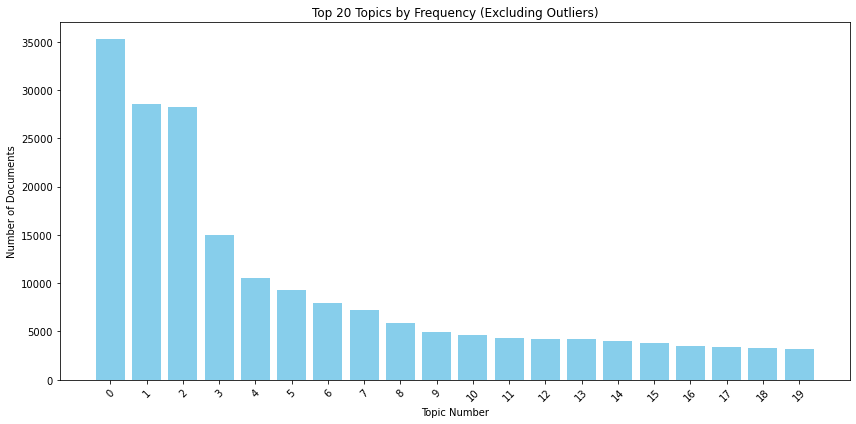

In [6]:
# Get top topic frequencies, excluding -1
topic_freq = bertopic_model.get_topic_freq()
topic_freq = topic_freq[topic_freq["Topic"] != -1].head(20)

# Plot
plt.figure(figsize=(12, 6))
plt.bar(topic_freq["Topic"].astype(str), topic_freq["Count"], color="skyblue")
plt.xlabel("Topic Number")
plt.ylabel("Number of Documents")
plt.title("Top 20 Topics by Frequency (Excluding Outliers)")
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()


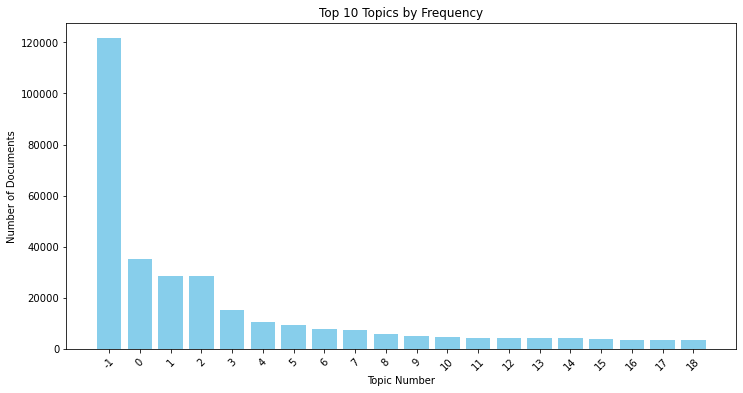

In [7]:
# Get top topic frequencies, including -1, outliers
topic_freq = bertopic_model.get_topic_freq().head(20)

plt.figure(figsize=(12, 6))
plt.bar(topic_freq["Topic"].astype(str), topic_freq["Count"], color="skyblue")
plt.xlabel("Topic Number")
plt.ylabel("Number of Documents")
plt.title("Top 10 Topics by Frequency")
plt.xticks(rotation=45)
plt.show()


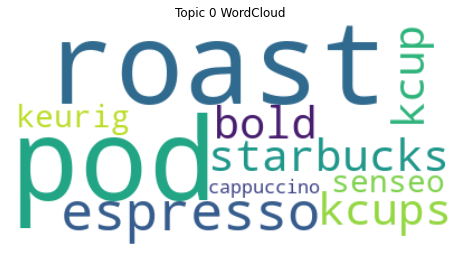

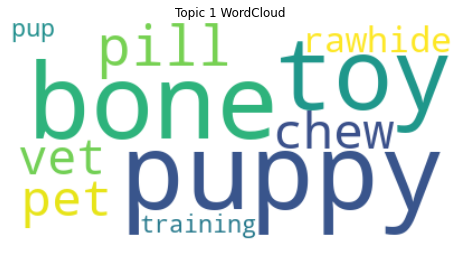

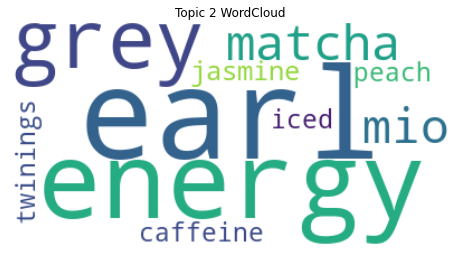

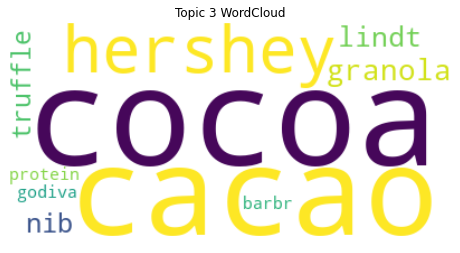

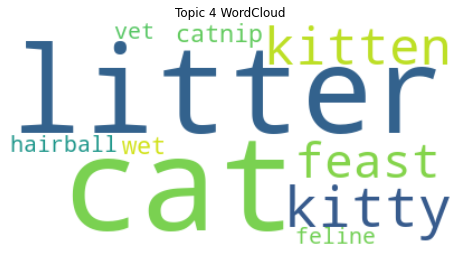

...

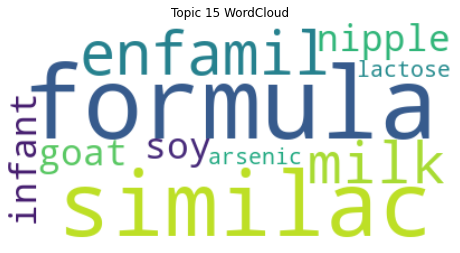

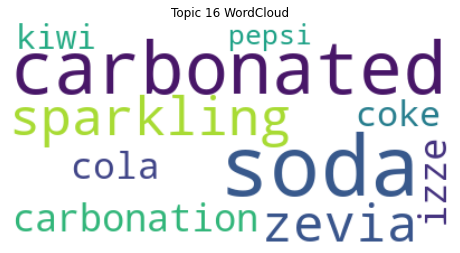

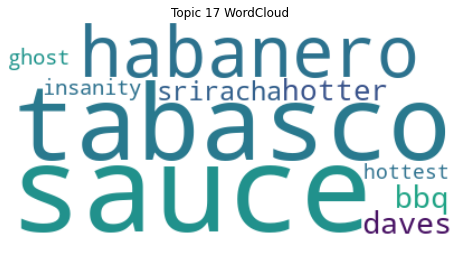

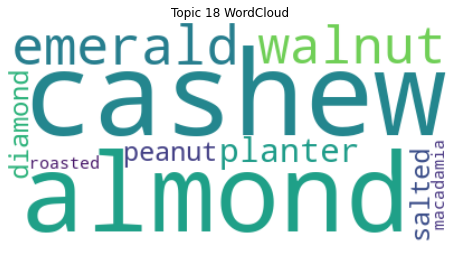

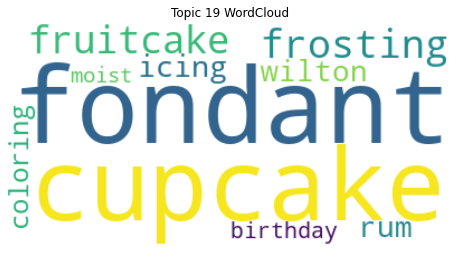

In [8]:
from wordcloud import WordCloud


for topic_num in range(20):  # Adjust as needed
    words_freq = {word: weight for word, weight in bertopic_model.get_topic(topic_num)}
    wordcloud = WordCloud(background_color='white').generate_from_frequencies(words_freq)

    plt.figure(figsize=(8, 5))
    plt.imshow(wordcloud, interpolation="bilinear")
    plt.axis("off")
    plt.title(f"Topic {topic_num} WordCloud")
    plt.show()

In [9]:
fig = bertopic_model.visualize_barchart(top_n_topics=20)
fig.show()
fig.write_image("topics_barchart_v3.png", width=1200, height=1920, scale=2)

In [10]:
# Ensure 'Assigned_Topic' column exists
if "Assigned_Topic" not in df.columns:
    df["Assigned_Topic"] = topics  # Assign topics

# Extract sample reviews for topics -1 to 19
for topic_num in range(-1, 20):
    print(f"\n🔹 Sample Reviews for Topic {topic_num}:")

    # Filter the DataFrame for the given topic
    topic_reviews = df[df["Assigned_Topic"] == topic_num]["Text"]

    # Check if reviews exist for the topic
    if not topic_reviews.empty:
        sample_reviews = topic_reviews.sample(min(3, len(topic_reviews)), random_state=42).tolist()
    else:
        sample_reviews = ["No reviews available for this topic."]

    print(sample_reviews)



🔹 Sample Reviews for Topic -1:
['The actual ingredients arent listed on the product page.  I should have known better.  This is nothing special.  Its basically the same thing as plain old unsweetened cocoa powder, only way more expensive.<br /><br />Trust me, if this were on a store shelf, you would look at the ingredients, nutritional information and price, and buy either Hersheys, or high end gourmet cocoa (which would cost no more)...', "Nana's Chocolate and chocolate Chip cookies are very tasty. They have no dairy and have all natural sugar (fruit juice) and no trans fat. I like they way they each have their own package so they stay fresher longer.<br />These are the kind of cookies that make you feel like you are eating healthier.", 'very tasty, not a bad price...I would buy it again, sent some to my son in college, he liked it, too, very tasty product']

🔹 Sample Reviews for Topic 0:
["Okay- I wasn't crazy impressed by the Mocha flavor on it's own, but I don't prefer coffee in g

["I discovered these crackers when my husband started a wheat-free diet. We really enjoy these crackers.  So many of the other crackers we had tried tasted like cardboard.  We were elated when we tried these!  They go great with soups, cheese and hummus.  Try them - you'll like them.", "Come on, people. You're eating cheap snack crackers. If you want a gourmet PB&J sandwich, make it yourself. But if you're looking for a quick taste of fond (or not so fond) memories of childhood. Its a quick tasty snack. Don't expect floods of grape and mounds of PB. Its just a nice subtle toasted cracker with undertones of PB&J. These reviews are like asking Cheez-It to taste like a fresh bite of Tillamock Cheddar. Ain't gonna happen. Buy them. If you like 'em, great. If not -- feed 'em to the kids or save 'em for Halloween Trick-Or-Treaters.", 'Back to Nature is a great company in regards to quality, taste and cost. These are my favorite crackers and I could honestly eat a whole box in one sitting. Th

["This is not a bad flavor, but it's not a good substitute for Dr Pepper like Veggie burgers are a not a good substitute for Hamburgers.<br /><br />This soda has more of a cherry overtone, but very little bite and is much sweeter than diet Dr Pepper. However, by itself as a new flavor, it's really good and I still would recommend it to others.", 'This Switch Kiwi Berry drink comes is as great, easy to handle, streamlined candy.  However, it does delivery an intense, fruit, flavor.  Great when you really need a sweet fruit recovery from a hot summer day.  Otherwise, a bit overpowering. A nice treat though.', "Loved this drink. The sweetness level was just right, and I really liked the fact this is 100% juice without corn syrup or refined sugar. I didn't really think the watermelon strawberry tasted like watermelon or strawberry, but it was a really nice, pleasant flavor. The carbonation was just right. I also liked that this drink didn't leave a weird aftertaste or a lingering flavor on

In [15]:
# Ensure DateTime is in datetime format
df["DateTime"] = pd.to_datetime(df["DateTime"])

# Compute topic evolution over time
topics_over_time = bertopic_model.topics_over_time(
    df["processed_text"].apply(lambda x: " ".join(x)).tolist(),
    timestamps=df["DateTime"].tolist(),
    nr_bins=15  # Adjust bins for granularity
)

# Extract only the 10 most relevant topics
selected_topics = list(range(0,20))  # Modify this list if needed

# Visualize only the selected topics
fig = bertopic_model.visualize_topics_over_time(topics_over_time, topics=selected_topics)
fig.show()
fig.write_image("topics_over_time_v3.png", width=1200, height=800, scale=2)

In [12]:
# Generate hierarchical topic clusters
hierarchical_topics = bertopic_model.hierarchical_topics(df["processed_text"].tolist())

# Visualize topic hierarchy
fig = bertopic_model.visualize_hierarchy(top_n_topics=50)  # You can adjust this number

# Show the figure (works in notebooks)
fig.show()
fig.write_html("topic_hierarchy_v3.html")

100%|██████████████████████████████████████████████████████████████████████████████████| 58/58 [00:01<00:00, 37.79it/s]
